<a href="https://colab.research.google.com/github/Ali-Banihashemi/Deep-Learning-Optimizers-and-SMOTE/blob/main/AI-Assignment1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Artificial Intelligence Course- 2024**

# **Assignment 1**




In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# 1:

First of all, what is an optimizer?

In neural network designing we need an algorithm which can help us to set the weights between each pair of neurons, in a way that our neural network works best at the job that we want it to. This algorithm is called The optimizer.

There is no discussion about optimizers which doesn't start with the name "Gradient Descent".

Gradient Descent is the Grandfather of all the optimizers but it's not that good of an optimizer. The problem with it is that this optimizer update the weights only once after every epoch which makes our steps far too big and some times we may not reach the global or local minima at all.

The solution to this problem is Stochastic Gradient Descent or SGD. SGD's advantage over normal Gradient Descent is that in SGD we update weights once after every sample in our dataset. This way we make our steps very small and we will reach the goal of finding minimums at last.

Let's take a quick look at the SGD formula.

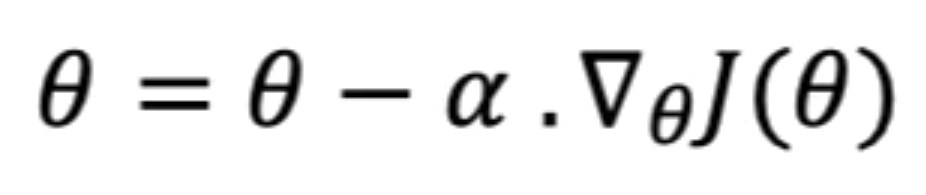

In [ ]:
from IPython.display import Image
Image(filename='/content/drive/MyDrive/AI-Assignment1/SGD.png',width=463,height=98)

This is pretty straight forward. In each step weights which are represented with Theta are going to change based on the learning rate(alpha) and the gradient.
Everything looks fine for now but there are still some problems. This optimizer is taking very small steps,so it may take a while until we can find the global minimum and some times we can't find it at all.

why?

As we said earlier there will be a result at last but some times this result would be just a local minima and not the actual global minimum. That's because our little steps lead to getting stuck in a local minima.

So we can move on and reach better optimizers such as SGD + Momentum.

First let's talk about how it works and then we will see the formula.



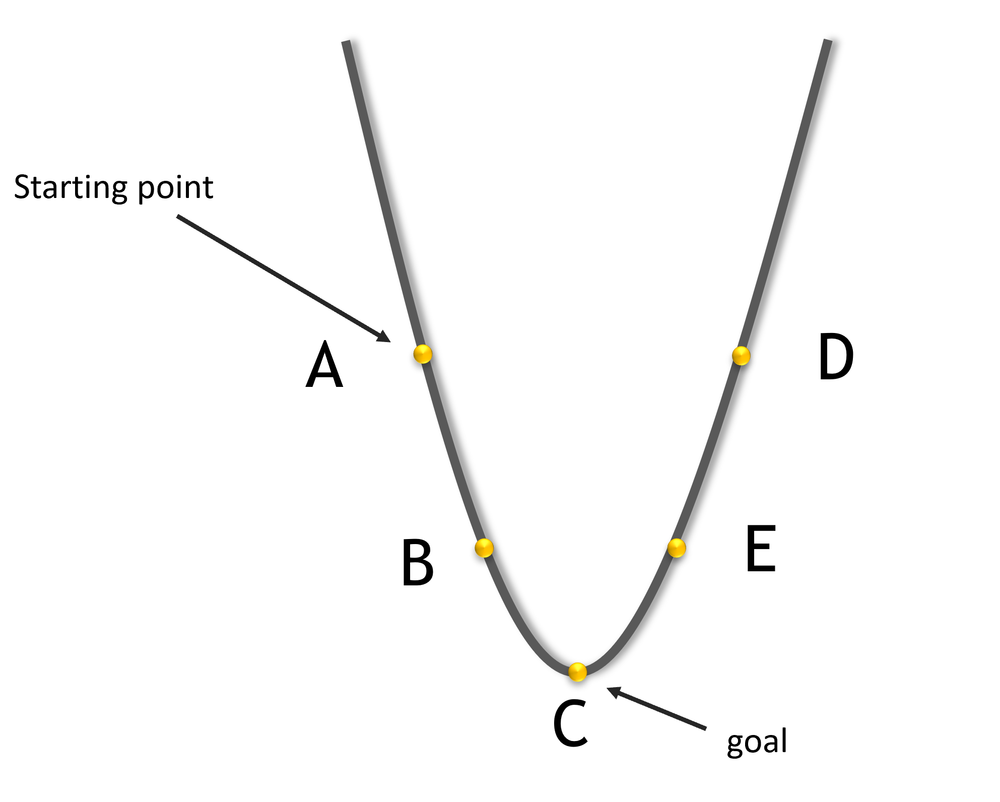

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Assignment1/parabola.png',width=600,height=500)

Suppose we are at the point A and our optimizer should help us to reach the point C.

In the following video, the helicopter's location is the situation of our cost function and gales are those datas which suggest the helicopter should move backwards to reach the goal.

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

save_path = "/content/drive/MyDrive/AI-Assignment1/SGDvsSGDM.mp4"


compressed_path = "/content/drive/MyDrive/AI-Assignment1/SGDvsSGDM.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")


mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=500 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In normal SGD in each step we move and wait for another step to happen and this can lead to moving backwards because of a misleading data(gale) and generally it is slow.

In the other hands in SGD+momentum altough we may have diffrent velocities at each step we just move forward and a misleading data can just decrease our velocity. However in the end we will pass the point C (goal) because of the velocity and this time actual datas work like gales and make us reach the goal.

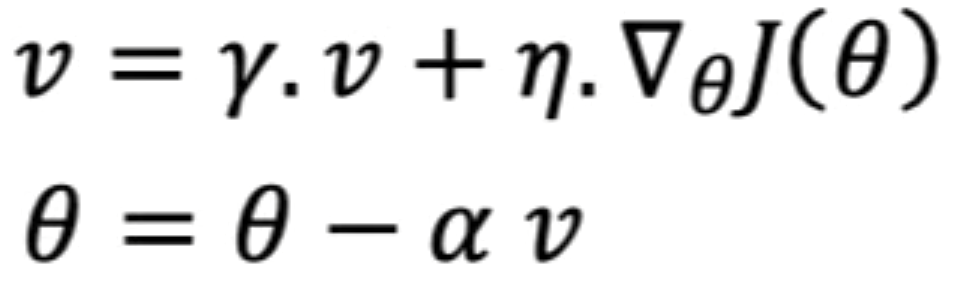

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Assignment1/SGDM.png',width=450,height=140)

In SGD + Momentum in each step we have a momentum which is calculated in the last step, Gamma is a hyperparameter which acts like a weight to our current momentum. In other words this hyperparameter and learning rate both determine how much our new momentum is related to the last momentum and how much it is related to the gradient.

For example if gamma=1, then we know our last velocity is kept completely and the gradient can increase or decrease it.

The learning rate and gradient part are completely similar to the normal SGD.

In the end we will use momentum( it can have it's own weight like alpha but it's not necessary) to calculate the new weights.

In conclusion in SGD+Momentum we care about how we changed the weights in last steps until now and our velocity is based on that.

AdaGrad

AdaGrad or Adaptive Gradient Algorithm is another optimizer. In this one learning rate changes for each parameter during training.

This way we can choose to use bigger or smaller steps based on each parameter’s significance to the optimization process.

Regullary our steps are bigger at the beginning and as we get closer to the goal our steps get smaller.

Let's take a look on how this is done.

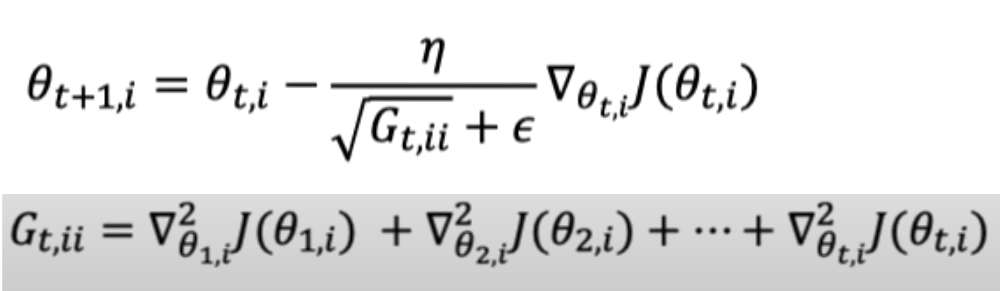

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Assignment1/AdaGrad.png',width=850,height=250)

As always weights are shown with Theta. First argument of the Theta is time-step and the second one is the index of that particular weight. As we mentioned before we are going to adjust weights individually. All the parts are similar to the SGD except the learning rate. Instead of a constant learning rate we have bonded a function called G to the learning rate so the learning rate does change, but how?

G is calculated based on all the gradients from the first time-step until now , so it is basically calculating how much this i'th' weight should change based on previous gradients.

After calculating G the higher it is the lower the learning rate will be so we can be more precise. The square and root thing is because we want the G result to be positive and the epsilon is there because G can be zero but we can't devide anything by zero.

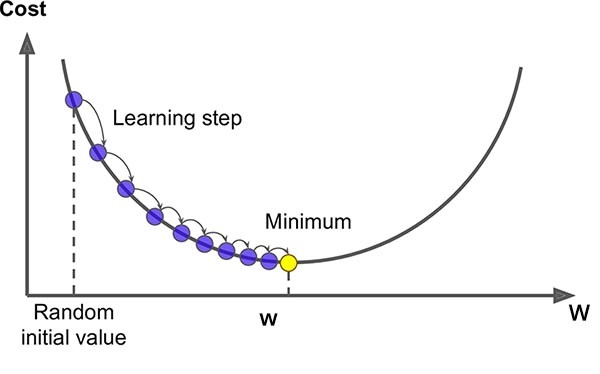

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Assignment1/Adagrad1D.png',width=400,height=250)

Here we can see how the steps are getting smaller as we are reaching the minimum.

Although AdaGrad is much better than SGD and SGD+Momentum it still has some problems. The main problem is that in AdaGrad the G function can get really large and this leads to a really small learning rate. We want the learning rate to get smaller over time but not so small that new weight is almost the same as the previous one. With this being said, we can start discussing about the RMSProp.

RMSProp or Root Mean Squared Propagation is basically an improved version of adagrad.It also looks like SGD+Momentum in some ways.
In RMSProp exponentially moving average is calculated for squared gradients. This way the importance of the last few gradients are much higher than the first or the second gradient. As it sounds more logical this way , it actually works better as well and converges faster towards the answer.


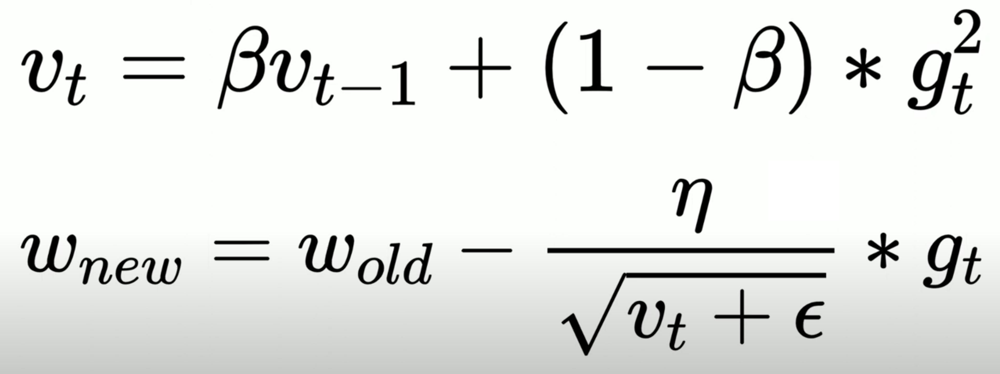

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Assignment1/RMSProp.png',width=600,height=250)

As we can see like the adagrad we have variable learning rates. I think it gets more clear if we look at V equation as a recursive function. The hyperparameter beta is between 0 and 1. So in each step gradients of previous steps are multiplied by a number between 0 and 1 so they get smaller. Suppose we are calculating V4 in that case g1 is multiplied by beta^3 (until now) and g3 is multiplied by beta^1. It's obvious that g3 gonna influence our V4 more than g1 and g4 gonna influence it the most.

RMSProp never leads to very small steps as it decreases the influence of very first steps. Vt is a more sensible function than G in AdaGrad in general.

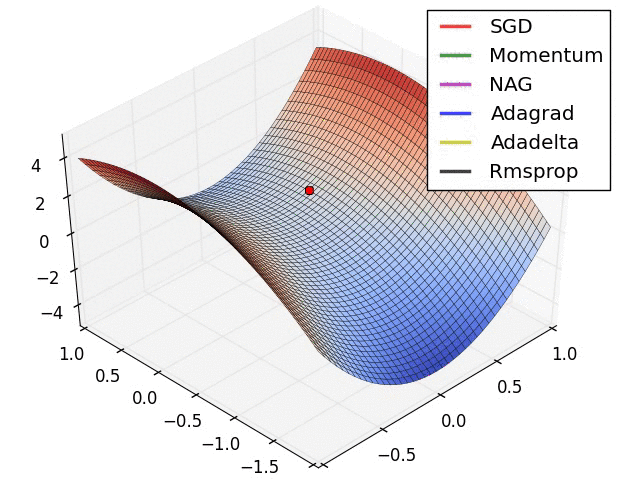

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Assignment1/Adagrad2D.gif',width=620,height=480)

In this picture this diffrence is obvious. AdaGrads steps are getting ridiculously small near the end and this behaviour increases the run time as well.



# 2:
Altough nearly all advantages and disadvantages can be concluded from the first part , We will list them here as a conclusion.

**SGD+Momentum**

Advantages:

Faster Convergence: The momentum helps accelerate convergence by speeding up convergence in the relevant direction. (In the helicopter example it is the resistance in front of gales.)

Escape from Local Minima: Momentum helps the optimizer escape local minima by allowing it to jump out of small holes.


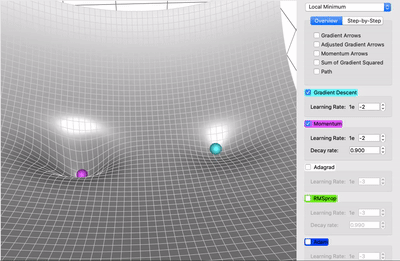

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Assignment1/SGDvsSGDM2.gif',width=400,height=200)

In this picture we can see this advantage and how SGD gets stuck in the local minima.

As it's a fairly simple optimizer, its advantages are meaningful in comparison to an optimizer like normal SGD. In comparison to more sophisticated optimizers we can mention simple implementation as an advantage.

Disadvantages:

Adds a new hyperparameter: The Gamma in SGD+Momentum is an additional hyperparameter which should be determined and it adds to the work.

Over-shooting: The momentum can lead the optimizer to overshoot the minimum point and this can lead to divergence.

**AdaGrad**

Advantages:

Even faster: Adagrad adapts the learning rate for each weight individually based on the previous gradients and this can lead to a fast and accurate result.

Auto Learning Rates : There is no need to think a lot about the value of the learning rate as it gonna change.

Disadvantages:

Learning Rates can get really small: After many steps, learning rates can get really small and this can ruin the learning process as the weights are not changing effectively anymore.

Storage of previous gradients: We should store all the previous gradients as we need them to calculate new ones and that needs storage.

**RMSProp**

Advantages:

Better adaptivity: This algorithm decreases the influence of too early gradients so our steps never gets really small.

Reliability: RMSProp is better than AdaGrad as it's important to change influence of diffrent gradients on the current weight because some of them may be too irrelevant.

Disadvantages:

Storage: It is better than AdaGrad but it still requires storing the moving average and this needs storage.



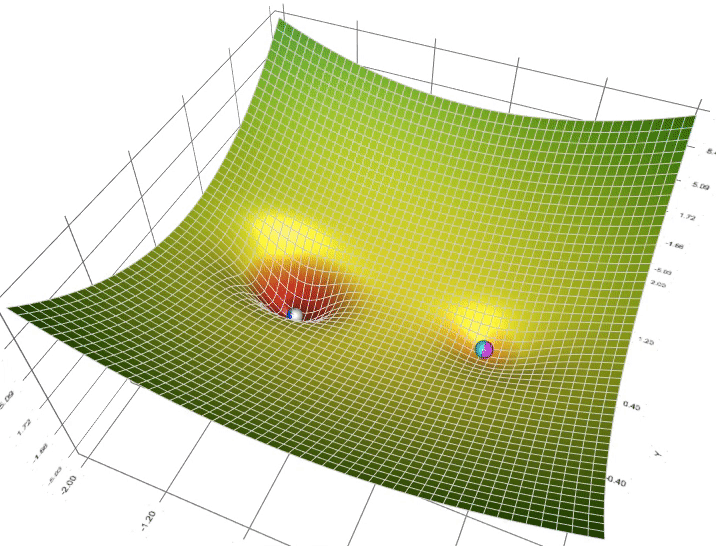

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Assignment1/optimizers.gif',width=600,height=480)

Gradient Descent (cyan), SGD+Momentum (magenta), AdaGrad (white), RMSProp (green), Adam (blue).
Adam is a variant of RMSProp.

The choice of optimizer is heavily related to the task and its requirements but generally between these three optimizers RMSProp (and Adam) are most used in the real-world applications. However there is still usage for every single one of these optimizers in the real-world.

# 3:

Smote is kind of a basic over-sampling algorithm. It works by generating new samples based on available samples.

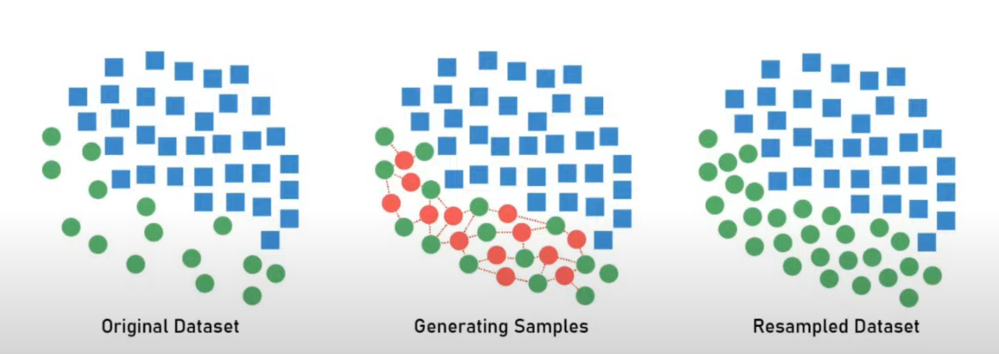

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Assignment1/smote2.png',width=750,height=250)

This algorithm choose a random sample and choose one of it's neighbours. Then it will generate a new sample by kind of merging these two samples. It continues on other neighbours and other samples until we reach a balanced dataset.

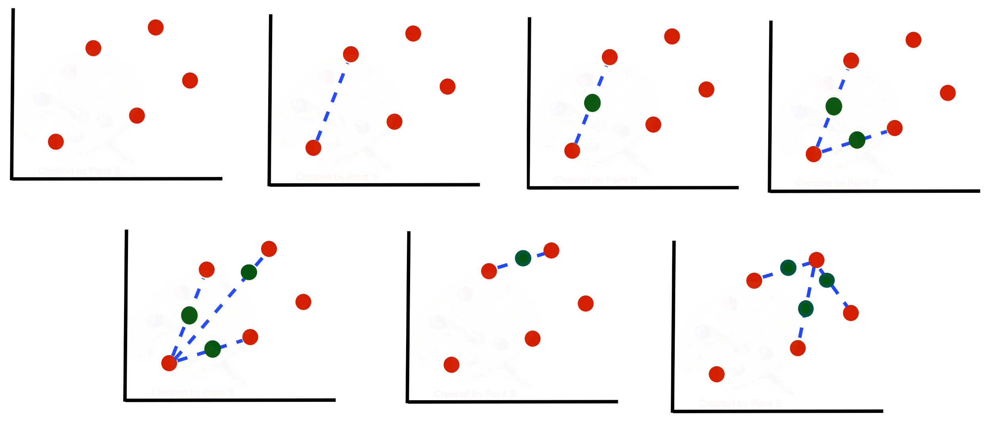

In [ ]:
Image(filename='/content/drive/MyDrive/AI-Assignment1/smote1.png',width=600,height=250)

These are the steps of choosing a pair of samples and generate another.

Let's start on the famous heart attack example.

We do imports , plt,confusion_matrix,ConfusionMatrixDisplay are for plotting
minmaxscaler is for normalization
Sequential and sense is there for designing our model
train_test_split is a built in function that splits data to training and validation


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import sklearn
import pandas as pd
import keras
from keras.models import Sequential
from keras.layers import Dense
import tensorflow as tf
from sklearn.metrics import confusion_matrix,ConfusionMatrixDisplay
from sklearn.preprocessing import MinMaxScaler

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/AI-Assignment1/heart.csv")

FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/AI-Assignment1/heart.csv'

we know the name of labels column in the dataset is target so we split these labels into another dataset.
then we remove it from the main one

In [ ]:
target_column = "output"
numerical_column = df.columns.drop(target_column)
output_rows = df[target_column]
df.drop(target_column,axis=1,inplace=True)

This part scales the features to have a mean of 0 and a standard deviation of 1.This normalization helps a lot in getting more accurate results.

In [ ]:
scaler = MinMaxScaler()
scaler.fit(df)
t_df = scaler.transform(df)

Here we use a function to split our datas into training and testing datasets.

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(t_df, output_rows, test_size=0.20, random_state=0)

Here we define our model and our optimizer is gonna be adam.
Then we fit the model.

In [ ]:
basic_model = Sequential()
basic_model.add(Dense(units=16, activation='relu', input_shape=(13,)))
basic_model.add(Dense(1, activation='sigmoid'))
adam = keras.optimizers.Adam(learning_rate=0.001)
basic_model.compile(loss='binary_crossentropy', optimizer=adam, metrics=["accuracy"])

In [ ]:
basic_model.fit(X_train, y_train, epochs=20,verbose=1)

Epoch 1/20
8/8 [==============================] - 0s 4ms/step - loss: 0.4811 - accuracy: 0.7975
Epoch 2/20
8/8 [==============================] - 0s 3ms/step - loss: 0.4741 - accuracy: 0.7975
Epoch 3/20
8/8 [==============================] - 0s 3ms/step - loss: 0.4676 - accuracy: 0.7975
Epoch 4/20
8/8 [==============================] - 0s 3ms/step - loss: 0.4617 - accuracy: 0.8017
Epoch 5/20
8/8 [==============================] - 0s 4ms/step - loss: 0.4557 - accuracy: 0.8017
Epoch 6/20
8/8 [==============================] - 0s 4ms/step - loss: 0.4502 - accuracy: 0.7975
Epoch 7/20
8/8 [==============================] - 0s 4ms/step - loss: 0.4455 - accuracy: 0.7975
Epoch 8/20
8/8 [==============================] - 0s 5ms/step - loss: 0.4407 - accuracy: 0.8017
Epoch 9/20
8/8 [==============================] - 0s 3ms/step - loss: 0.4363 - accuracy: 0.8099
Epoch 10/20
8/8 [==============================] - 0s 4ms/step - loss: 0.4331 - accuracy: 0.8099
Epoch 11/20
8/8 [======================

After fitting we can see that accuracy of fiiting was 83%.

Here we compare predicted output of model and actual outputs in validation set and calculate the accuracy. Then we plot them into a confusion matrix.

2/2 [==============================] - 0s 9ms/step


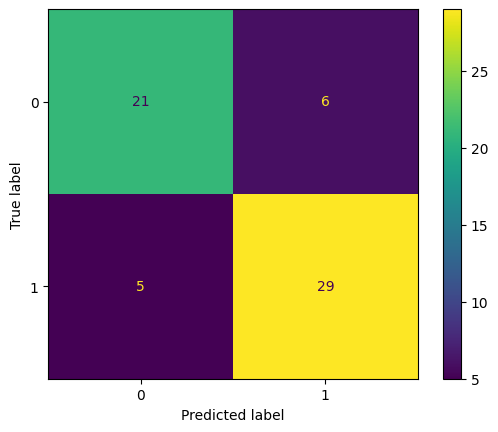

In [ ]:
predicted = basic_model.predict(X_test)
predicted = tf.squeeze(predicted)
predicted = np.array([1 if x >= 0.5 else 0 for x in predicted])
actual = np.array(y_test)
conf_mat = confusion_matrix(actual, predicted)
displ = ConfusionMatrixDisplay(confusion_matrix=conf_mat)
displ.plot()

After testing the testing accuracy is 78%.

This was a balanced dataset as the number of people who are going to have a heart attack was 166 and the number of the others was 138

Now we are going to test it on another dataset but this time we will have less healthy people .

This code is completely similar except we are using a diffrent dataset.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import sklearn
import pandas as pd
import keras
from keras.models import Sequential
from keras.layers import Dense
import tensorflow as tf
from sklearn.metrics import confusion_matrix,ConfusionMatrixDisplay
from sklearn.preprocessing import MinMaxScaler
df2 = pd.read_csv("/content/drive/MyDrive/AI-Assignment1/heart-imbalanced2.csv")
target_column = "output"
numerical_column2 = df2.columns.drop(target_column)
output_rows2 = df2[target_column]
df2.drop(target_column,axis=1,inplace=True)
scaler2 = MinMaxScaler()
scaler2.fit(df2)
t_df2 = scaler2.transform(df2)
X_train2, X_test2, y_train2, y_test2 = train_test_split(t_df2, output_rows2, test_size=0.20, random_state=0)
basic_model2 = Sequential()
basic_model2.add(Dense(units=16, activation='relu', input_shape=(13,)))
basic_model2.add(Dense(1, activation='sigmoid'))
adam2 = keras.optimizers.Adam(learning_rate=0.001)
basic_model2.compile(loss='binary_crossentropy', optimizer=adam2, metrics=["accuracy"])
X_train2.shape

(165, 13)

In [ ]:
basic_model2.fit(X_train2, y_train2, epochs=20,verbose=1)

Epoch 1/20
6/6 [==============================] - 1s 3ms/step - loss: 0.6366 - accuracy: 0.7030
Epoch 2/20
6/6 [==============================] - 0s 3ms/step - loss: 0.6164 - accuracy: 0.7697
Epoch 3/20
6/6 [==============================] - 0s 5ms/step - loss: 0.5972 - accuracy: 0.7818
Epoch 4/20
6/6 [==============================] - 0s 5ms/step - loss: 0.5822 - accuracy: 0.7879
Epoch 5/20
6/6 [==============================] - 0s 4ms/step - loss: 0.5675 - accuracy: 0.7879
Epoch 6/20
6/6 [==============================] - 0s 5ms/step - loss: 0.5563 - accuracy: 0.7879
Epoch 7/20
6/6 [==============================] - 0s 6ms/step - loss: 0.5469 - accuracy: 0.7879
Epoch 8/20
6/6 [==============================] - 0s 5ms/step - loss: 0.5380 - accuracy: 0.7879
Epoch 9/20
6/6 [==============================] - 0s 5ms/step - loss: 0.5317 - accuracy: 0.7879
Epoch 10/20
6/6 [==============================] - 0s 5ms/step - loss: 0.5248 - accuracy: 0.7879
Epoch 11/20
6/6 [======================

2/2 [==============================] - 0s 6ms/step


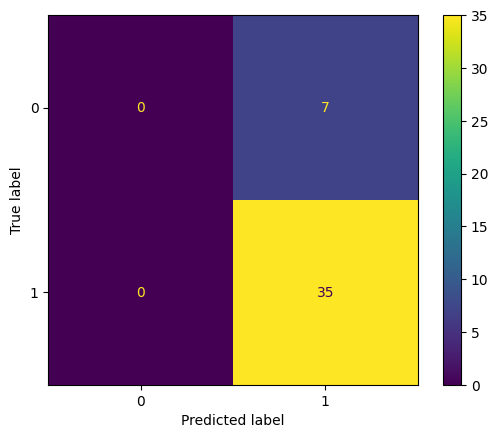

In [ ]:
predicted2 = basic_model2.predict(X_test2)
predicted2 = tf.squeeze(predicted2)
predicted2 = np.array([1 if x >= 0.5 else 0 for x in predicted2])
actual2 = np.array(y_test2)
conf_mat = confusion_matrix(actual2, predicted2)
displ = ConfusionMatrixDisplay(confusion_matrix=conf_mat)
displ.plot()

Fitting accuracy was 78% and testing accuracy is 86 percent.

For smote, first we import it , then we resample training data using it, after that we fit the model again.

In [ ]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state = 27)

smote_X_train , smote_y_train = smote.fit_resample(X_train,y_train)

smote_X_train.shape

(262, 13)

In [ ]:
basic_model2.fit(smote_X_train, smote_y_train, epochs=20,verbose=1)

Epoch 1/20
9/9 [==============================] - 0s 5ms/step - loss: 0.7424 - accuracy: 0.5000
Epoch 2/20
9/9 [==============================] - 0s 4ms/step - loss: 0.7040 - accuracy: 0.5115
Epoch 3/20
9/9 [==============================] - 0s 3ms/step - loss: 0.6646 - accuracy: 0.5458
Epoch 4/20
9/9 [==============================] - 0s 5ms/step - loss: 0.6352 - accuracy: 0.6069
Epoch 5/20
9/9 [==============================] - 0s 4ms/step - loss: 0.6154 - accuracy: 0.6794
Epoch 6/20
9/9 [==============================] - 0s 4ms/step - loss: 0.5993 - accuracy: 0.7099
Epoch 7/20
9/9 [==============================] - 0s 4ms/step - loss: 0.5897 - accuracy: 0.7481
Epoch 8/20
9/9 [==============================] - 0s 4ms/step - loss: 0.5823 - accuracy: 0.7634
Epoch 9/20
9/9 [==============================] - 0s 4ms/step - loss: 0.5761 - accuracy: 0.7748
Epoch 10/20
9/9 [==============================] - 0s 4ms/step - loss: 0.5691 - accuracy: 0.7824
Epoch 11/20
9/9 [======================

2/2 [==============================] - 0s 4ms/step


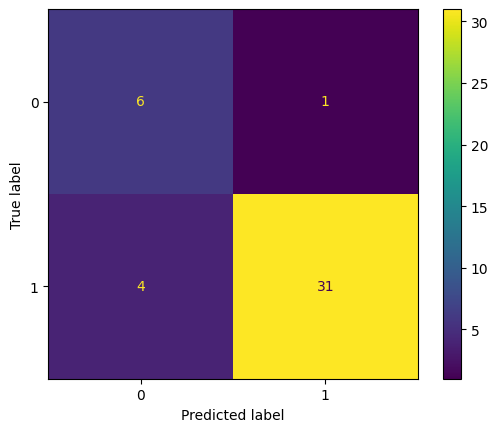

In [ ]:
predicted2 = basic_model2.predict(X_test2)
predicted2 = tf.squeeze(predicted2)
predicted2 = np.array([1 if x >= 0.5 else 0 for x in predicted2])
actual2 = np.array(y_test2)
conf_mat = confusion_matrix(actual2, predicted2)
displ = ConfusionMatrixDisplay(confusion_matrix=conf_mat)
displ.plot()

Fitting accuracy was 80% and testing accuracy is 86 percent.

As we can see after generating new healthy datas, our fitting accuracy is increased.

# 4:

Everything is completely the same except we are using a diffrent method to seperate output and the data. The model is diffrent as well. We used evaluate method to calculate validation accuracy after fitting.

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

df = pd.read_csv("/content/drive/MyDrive/AI-Assignment1/Dataset.csv")
X = df.iloc[:, :92].values
y = df.iloc[:, 92].values

scaler2 = MinMaxScaler()
scaler2.fit(X)
X = scaler2.transform(X)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=0)

model = Sequential([
    Dense(units=128, activation='relu', input_shape=(92,)),
    Dense(units=64, activation='relu'),
    Dense(units=32, activation='relu'),
    Dense(units=3, activation='softmax')
])

model.compile(optimizer='adam',loss='sparse_categorical_crossentropy',  metrics=['accuracy'])
history = model.fit(X_train, y_train, epochs=20, batch_size=32, validation_data=(X_test, y_test))
test_loss, test_accuracy = model.evaluate(X_test, y_test)

print("Test Loss:", test_loss)
print("Test Accuracy:", test_accuracy)

Epoch 1/20
2783/2783 [==============================] - 10s 3ms/step - loss: 0.7303 - accuracy: 0.6264 - val_loss: 0.7165 - val_accuracy: 0.6259
Epoch 2/20
2783/2783 [==============================] - 8s 3ms/step - loss: 0.6901 - accuracy: 0.6453 - val_loss: 0.6992 - val_accuracy: 0.6422
Epoch 3/20
2783/2783 [==============================] - 9s 3ms/step - loss: 0.6780 - accuracy: 0.6501 - val_loss: 0.6919 - val_accuracy: 0.6427
Epoch 4/20
2783/2783 [==============================] - 10s 4ms/step - loss: 0.6674 - accuracy: 0.6573 - val_loss: 0.6769 - val_accuracy: 0.6473
Epoch 5/20
2783/2783 [==============================] - 8s 3ms/step - loss: 0.6587 - accuracy: 0.6606 - val_loss: 0.6776 - val_accuracy: 0.6547
Epoch 6/20
2783/2783 [==============================] - 9s 3ms/step - loss: 0.6516 - accuracy: 0.6661 - val_loss: 0.6683 - val_accuracy: 0.6606
Epoch 7/20
2783/2783 [==============================] - 10s 3ms/step - loss: 0.6466 - accuracy: 0.6688 - val_loss: 0.6650 - val_accura

History keeps track of loss and accuracy during fitting so we can access that data to plot loss and accuracy changes.

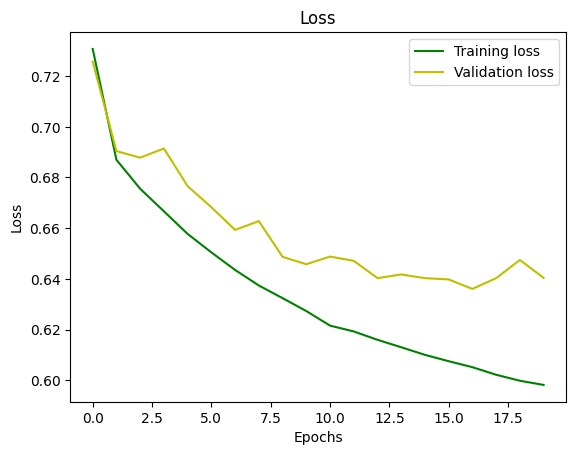

In [ ]:
plt.plot(history.epoch, history.history["loss"], 'g', label='Training loss')
plt.plot(history.epoch, history.history["val_loss"], 'y', label='Validation loss')
plt.title('Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

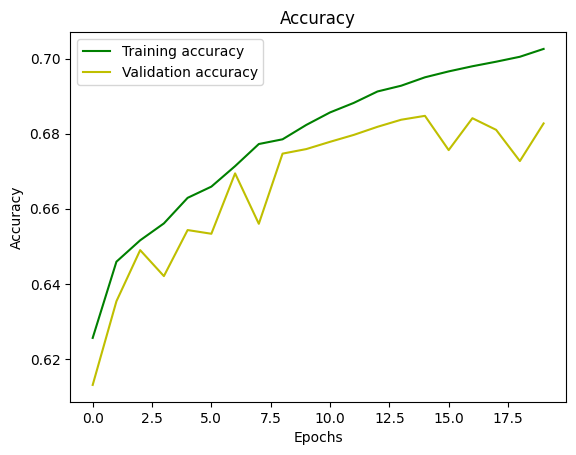

In [ ]:
plt.plot(history.epoch, history.history["accuracy"], 'g', label='Training accuracy')
plt.plot(history.epoch, history.history["val_accuracy"], 'y', label='Validation accuracy')
plt.title('Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

Now let's use adagrad and rmsprop and compare the results.

In [ ]:
model.compile(optimizer='adagrad',loss='sparse_categorical_crossentropy',  metrics=['accuracy'])
history = model.fit(X_train, y_train, epochs=20, batch_size=32, validation_data=(X_test, y_test))
test_loss, test_accuracy = model.evaluate(X_test, y_test)

print("Test Loss:", test_loss)
print("Test Accuracy:", test_accuracy)

Epoch 1/20
2783/2783 [==============================] - 10s 3ms/step - loss: 0.5820 - accuracy: 0.7122 - val_loss: 0.6290 - val_accuracy: 0.6913
Epoch 2/20
2783/2783 [==============================] - 7s 2ms/step - loss: 0.5781 - accuracy: 0.7140 - val_loss: 0.6280 - val_accuracy: 0.6921
Epoch 3/20
2783/2783 [==============================] - 8s 3ms/step - loss: 0.5766 - accuracy: 0.7146 - val_loss: 0.6275 - val_accuracy: 0.6924
Epoch 4/20
2783/2783 [==============================] - 7s 2ms/step - loss: 0.5756 - accuracy: 0.7154 - val_loss: 0.6273 - val_accuracy: 0.6922
Epoch 5/20
2783/2783 [==============================] - 8s 3ms/step - loss: 0.5749 - accuracy: 0.7157 - val_loss: 0.6272 - val_accuracy: 0.6918
Epoch 6/20
2783/2783 [==============================] - 7s 2ms/step - loss: 0.5743 - accuracy: 0.7162 - val_loss: 0.6273 - val_accuracy: 0.6913
Epoch 7/20
2783/2783 [==============================] - 8s 3ms/step - loss: 0.5739 - accuracy: 0.7160 - val_loss: 0.6271 - val_accuracy

We learned about using SMOTE and that's not a big deal actually.

In [ ]:
from imblearn.over_sampling import SMOTE
smote = SMOTE(random_state = 0)

smote_X , smote_y = smote.fit_resample(X,y)
smote_X_train, smote_X_test, smote_y_train, smote_y_test = train_test_split(smote_X, smote_y, test_size=0.20, random_state=0)

model.compile(optimizer='adagrad',loss='sparse_categorical_crossentropy',  metrics=['accuracy'])
history = model.fit(smote_X_train, smote_y_train, epochs=20, batch_size=32, validation_data=(smote_X_test, smote_y_test))
test_loss, test_accuracy = model.evaluate(smote_X_test, smote_y_test)

print("Test Loss:", test_loss)
print("Test Accuracy:", test_accuracy)

Epoch 1/20
4291/4291 [==============================] - 13s 3ms/step - loss: 0.5605 - accuracy: 0.7440 - val_loss: 0.5645 - val_accuracy: 0.7453
Epoch 2/20
4291/4291 [==============================] - 13s 3ms/step - loss: 0.5593 - accuracy: 0.7449 - val_loss: 0.5644 - val_accuracy: 0.7452
Epoch 3/20
4291/4291 [==============================] - 14s 3ms/step - loss: 0.5588 - accuracy: 0.7449 - val_loss: 0.5643 - val_accuracy: 0.7450
Epoch 4/20
4291/4291 [==============================] - 17s 4ms/step - loss: 0.5584 - accuracy: 0.7453 - val_loss: 0.5642 - val_accuracy: 0.7452
Epoch 5/20
4291/4291 [==============================] - 20s 5ms/step - loss: 0.5580 - accuracy: 0.7451 - val_loss: 0.5641 - val_accuracy: 0.7455
Epoch 6/20
4291/4291 [==============================] - 13s 3ms/step - loss: 0.5578 - accuracy: 0.7455 - val_loss: 0.5641 - val_accuracy: 0.7455
Epoch 7/20
4291/4291 [==============================] - 13s 3ms/step - loss: 0.5575 - accuracy: 0.7456 - val_loss: 0.5640 - val_ac

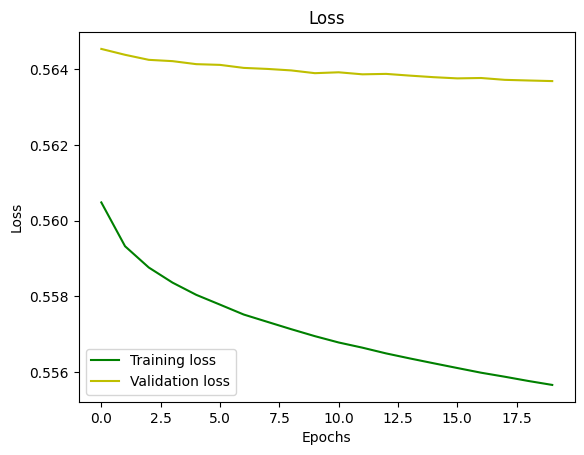

In [ ]:
plt.plot(history.epoch, history.history["loss"], 'g', label='Training loss')
plt.plot(history.epoch, history.history["val_loss"], 'y', label='Validation loss')
plt.title('Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

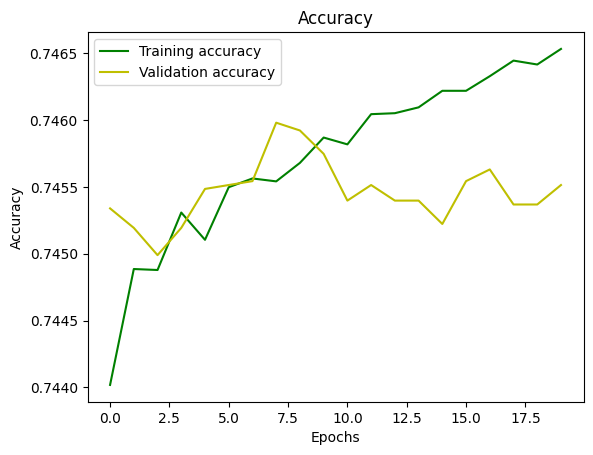

In [ ]:
plt.plot(history.epoch, history.history["accuracy"], 'g', label='Training accuracy')
plt.plot(history.epoch, history.history["val_accuracy"], 'y', label='Validation accuracy')
plt.title('Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [ ]:
model.compile(optimizer='rmsprop',loss='sparse_categorical_crossentropy',  metrics=['accuracy'])
history = model.fit(smote_X_train, smote_y_train, epochs=20, batch_size=32, validation_data=(smote_X_test, smote_y_test))
test_loss, test_accuracy = model.evaluate(smote_X_test, smote_y_test)

print("Test Loss:", test_loss)
print("Test Accuracy:", test_accuracy)

Epoch 1/20
4291/4291 [==============================] - 28s 6ms/step - loss: 0.5953 - accuracy: 0.7305 - val_loss: 0.6052 - val_accuracy: 0.7291
Epoch 2/20
4291/4291 [==============================] - 19s 4ms/step - loss: 0.5998 - accuracy: 0.7294 - val_loss: 0.6050 - val_accuracy: 0.7305
Epoch 3/20
4291/4291 [==============================] - 12s 3ms/step - loss: 0.6025 - accuracy: 0.7284 - val_loss: 0.6058 - val_accuracy: 0.7309
Epoch 4/20
4291/4291 [==============================] - 13s 3ms/step - loss: 0.6026 - accuracy: 0.7291 - val_loss: 0.6096 - val_accuracy: 0.7267
Epoch 5/20
4291/4291 [==============================] - 14s 3ms/step - loss: 0.6024 - accuracy: 0.7295 - val_loss: 0.6184 - val_accuracy: 0.7254
Epoch 6/20
4291/4291 [==============================] - 13s 3ms/step - loss: 0.6022 - accuracy: 0.7308 - val_loss: 0.6076 - val_accuracy: 0.7291
Epoch 7/20
4291/4291 [==============================] - 13s 3ms/step - loss: 0.6019 - accuracy: 0.7309 - val_loss: 0.6098 - val_ac

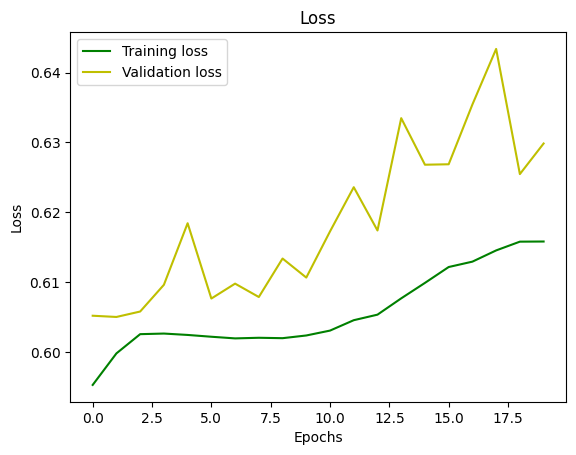

In [ ]:
plt.plot(history.epoch, history.history["loss"], 'g', label='Training loss')
plt.plot(history.epoch, history.history["val_loss"], 'y', label='Validation loss')
plt.title('Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

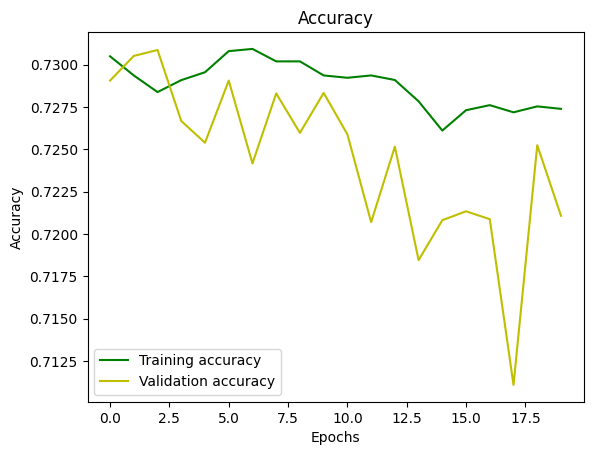

In [ ]:
plt.plot(history.epoch, history.history["accuracy"], 'g', label='Training accuracy')
plt.plot(history.epoch, history.history["val_accuracy"], 'y', label='Validation accuracy')
plt.title('Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()